# 04 Validate SAM

## Set up Modelling Environment

In [ ]:
# Install libraries
!pip install gcsfs rasterio Pillow numpy matplotlib scikit-learn google-cloud-aiplatform protobuf

In [2]:
# Import libraries
import os
import gcsfs
import rasterio
import base64
import numpy as np
from PIL import Image
from io import BytesIO
from google.cloud import aiplatform
from google.protobuf import json_format
from google.protobuf.struct_pb2 import Value
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from typing import Dict, List, Union

## Set up Configurations

In [3]:
# Constants

# PROJECT_ID = '[your-project-id]' # @param {type:"string"}
PROJECT_ID = 'imposing-mind-398223'  # @param {type:"string"}

# Set the endpoint id
ENDPOINT_ID = '4945957344480591872'

# Set the project id
! gcloud config set project {PROJECT_ID}

# Set the region
REGION = 'us-central1' # @param {type: "string"}

# Set the alpha endpoint

API_ENDPOINT = "us-central1-aiplatform.googleapis.com"

# Set the Cloud Storage bucket
# BUCKET_URI = f"gs://your-bucket-name-{PROJECT_ID}-unique"  # @param {type:"string"}
BUCKET_URI = f"gs://meter-sam-imposing-mind-398223-unique"   # @param {type:"string"}

Updated property [core/project].


In [4]:
# Initialize Vertex AI SDK for Python
aiplatform.init(project=PROJECT_ID, location=REGION, staging_bucket=BUCKET_URI)

In [5]:
# Global variable to store the aggregated confusion matrix
aggregate_confusion = np.zeros((2, 2), dtype=int)

## Define functions

In [19]:
def list_files_in_gcs_bucket(bucket_path):
    """List files in a GCS bucket."""
    fs = gcsfs.GCSFileSystem(project='imposing-mind-398223')
    return fs.ls(bucket_path)
    # files = fs.ls(bucket_path)
    # return files[:10]

In [7]:
def predict_custom_trained_model_sample(
    instances: Union[Dict, List[Dict]],
    project: str = PROJECT_ID,
    endpoint_id: str = ENDPOINT_ID,
    location: str = REGION,
    api_endpoint: str = API_ENDPOINT,
):
    """
    Predict using a custom trained model.
    
    `instances` can be either single instance of type dict or a list
    of instances.
    """
    # The AI Platform services require regional API endpoints.
    client_options = {"api_endpoint": api_endpoint}
    # Initialize client that will be used to create and send requests.
    # This client only needs to be created once, and can be reused for multiple requests.
    client = aiplatform.gapic.PredictionServiceClient(client_options=client_options)
    # The format of each instance should conform to the deployed model's prediction input schema.
    instances = instances if isinstance(instances, list) else [instances]
    instances = [
        json_format.ParseDict(instance_dict, Value()) for instance_dict in instances
    ]
    parameters_dict = {}
    parameters = json_format.ParseDict(parameters_dict, Value())
    endpoint = client.endpoint_path(
        project=project, location=location, endpoint=endpoint_id
    )
    response = client.predict(
        endpoint=endpoint, instances=instances, parameters=parameters
    )
    print("response")
    print(" deployed_model_id:", response.deployed_model_id)
    # The predictions are a google.protobuf.Value representation of the model's predictions.
    predictions = response.predictions
    for prediction in predictions:
        # print(" prediction:", dict(prediction))
        return dict(prediction)

In [8]:
def base64_to_np_array(encoded_data):
    """Decode base64 data to numpy array."""
    return np.frombuffer(base64.b64decode(encoded_data), dtype=np.float32)

In [9]:
# Global variable to store the sum of accuracies
sum_of_accuracies = 0

In [10]:
def calculate_accuracy(predicted_mask, ground_truth_mask):
    """Calculate accuracy between predicted and ground truth masks."""
    # Ensure both masks have the same shape
    assert predicted_mask.shape == ground_truth_mask.shape, "Shapes of predicted and ground truth masks do not match."

    # Calculate the number of correct predictions
    correct_predictions = np.sum(predicted_mask == ground_truth_mask)
    
    # Calculate total number of predictions
    total_predictions = predicted_mask.size
    
    # Calculate accuracy
    accuracy = correct_predictions / total_predictions
    return accuracy

In [11]:
def compute_metrics(confusion_matrix):
    """Compute accuracy, precision, and recall from the confusion matrix."""
    tn, fp, fn, tp = confusion_matrix.ravel()
    
    # Calculate accuracy
    matric_accuracy = (tp + tn) / (tp + tn + fp + fn)
    
    # Calculate precision
    precision = tp / (tp + fp) if (tp + fp) != 0 else 0
    
    # Calculate recall
    recall = tp / (tp + fn) if (tp + fn) != 0 else 0
    
    # Calculate F1 Score
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) != 0 else 0
    
    return matric_accuracy, precision, recall, f1

In [12]:
def save_as_geotiff(data_array, file_name, transform, crs):
    """Save numpy array as a GeoTIFF file."""
    with rasterio.open(
            file_name, 
            'w', 
            driver='GTiff', 
            height=data_array.shape[0],
            width=data_array.shape[1], 
            count=1, 
            dtype=data_array.dtype,
            crs=crs,
            transform=transform) as dst:
        dst.write(data_array, 1)

In [18]:
def visualize_and_compare_masks(mask_prob_array, mask_predict_array, gcs_path, file_name, transform, crs):
    """Visualize, compare, and save masks."""
    mask_prob_array, mask_predict_array = mask_prob_array.reshape(256, 256), mask_predict_array.reshape(256, 256)
    fs = gcsfs.GCSFileSystem(project='imposing-mind-398223')
    with fs.open(gcs_path+'mask/'+file_name, 'rb') as f, rasterio.open(f) as src:
        ground_truth_array = src.read(1)
        
    # fig, ax = plt.subplots(1, 3, figsize=(18, 6))
    # ax[0].imshow(mask_prob_array, cmap='viridis')
    # ax[0].set_title('Mask Probability')
    # ax[1].imshow(mask_predict_array, cmap='gray')
    # ax[1].set_title('Predicted Mask')
    # ax[2].imshow(ground_truth_array, cmap='gray')
    # ax[2].set_title('Ground Truth Mask')
    # plt.tight_layout()
    # plt.show()

    save_as_geotiff(mask_prob_array, 'satellite_images/predict/probability/' + file_name, transform, crs)
    save_as_geotiff(mask_predict_array, 'satellite_images/predict/mask/' + file_name, transform, crs)

    return mask_predict_array, ground_truth_array

In [14]:
def process_file(file_name, gcs_path):
    """Process each file, predict, visualize, and update confusion matrix."""
    fs = gcsfs.GCSFileSystem(project='imposing-mind-398223')
    with fs.open(gcs_path+'image/'+file_name, 'rb') as f, rasterio.open(f) as src:
        transform, crs, array = src.transform, src.crs, src.read().squeeze()
        # Convert to PNG
        img = Image.fromarray(array.astype(np.uint8))  # Make sure to cast to uint8
        buffer = BytesIO()
        img.save(buffer, format="PNG")
        png_data = buffer.getvalue()

    image_str = base64.b64encode(png_data).decode('utf-8')
    
    prediction = predict_custom_trained_model_sample(
        instances=[{"image": image_str}]
    )

    mask_predict_array, ground_truth_array = visualize_and_compare_masks(
        base64_to_np_array(prediction["mask_probability"]),
        base64_to_np_array(prediction["mask_prediction"]),
        gcs_path,
        file_name,
        transform,
        crs
    )
    
    # Calculate accuracy
    accuracy = calculate_accuracy(mask_predict_array, ground_truth_array)
    
    # Print accuracy for the current image
    print(f"Accuracy for {file_name}: {accuracy * 100:.2f}%")
    
    global sum_of_accuracies
    sum_of_accuracies += accuracy
    
     # Update the aggregate confusion matrix
    global aggregate_confusion
    aggregate_confusion += confusion_matrix(ground_truth_array.flatten(), mask_predict_array.flatten())

In [15]:
def main():
    """Main function to process all files and print aggregated confusion matrix."""
    gcs_path = 'gs://meter-sam/test/'
    all_files = list_files_in_gcs_bucket(gcs_path+'image/')
    tif_files = [os.path.basename(f) for f in all_files if f.endswith('.tif')]
    # print(tif_files)
    
    for file_name in tif_files:
        process_file(file_name, gcs_path)
    
    # Calculate and print average accuracy
    num_images = len(tif_files)
    average_accuracy = sum_of_accuracies / num_images if num_images else 0
    print(f"Average Accuracy: {average_accuracy * 100:.2f}%")    
    
    # Print the aggregated confusion matrix
    print("Aggregated Confusion Matrix:")
    print(aggregate_confusion)
    
    # Compute metrics
    matric_accuracy, precision, recall, f1 = compute_metrics(aggregate_confusion)
    print(f"Accuracy: {matric_accuracy * 100:.3f}%")
    print(f"Precision: {precision * 100:.3f}%")
    print(f"Recall: {recall * 100:.3f}%")
    print(f"F1 Score: {f1:.3f}")

## Start Validation

In [ ]:
if __name__ == "__main__":
    main()

## Upload Results to Google Cloud

In [ ]:
# Upload Images to the Google Cloud Bucket
os.system('gsutil -m cp -r satellite_images/predict gs://meter-sam/test')

## Example Results

In [ ]:
# results of test-5000-large* (*MF should load this back into VertexAI for analysis, or use something like weights-and-biases to save history)

In [ ]:
if __name__ == "__main__":
    main()

In [ ]:
# results of test-5000* (*MF should load this back into VertexAI for analysis, or use something like weights-and-biases to save history)

response
 deployed_model_id: 8120933509125636096


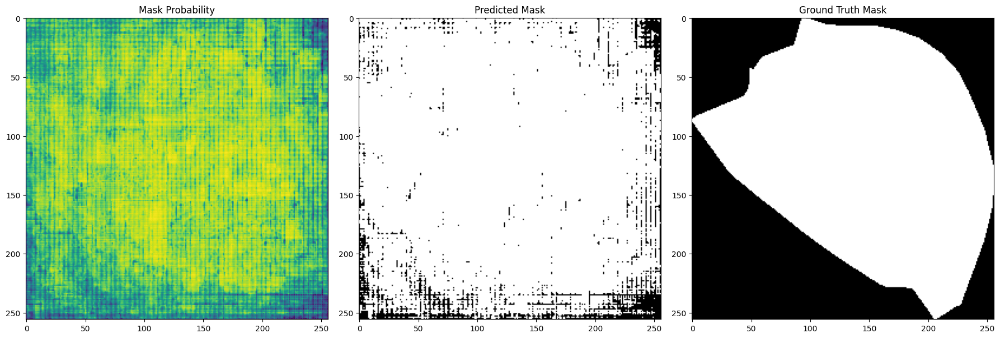

Accuracy for -1.09100572984569_50.8365984985021.tif: 65.47%
response
 deployed_model_id: 8120933509125636096


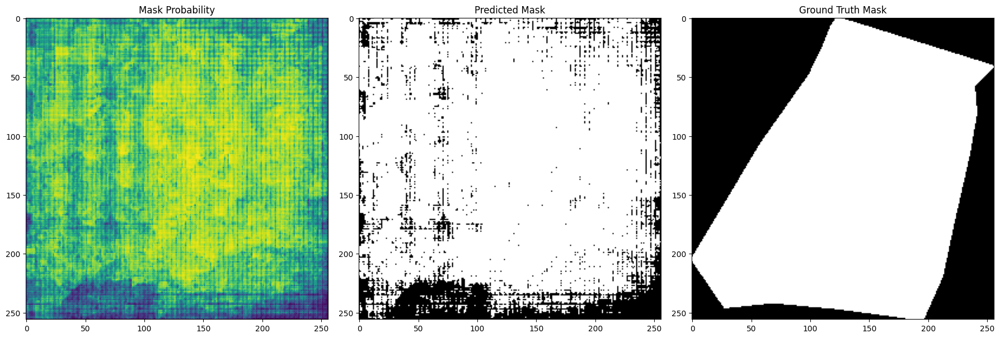

Accuracy for -1.28807687897428_53.1236555613774.tif: 67.79%
response
 deployed_model_id: 8120933509125636096


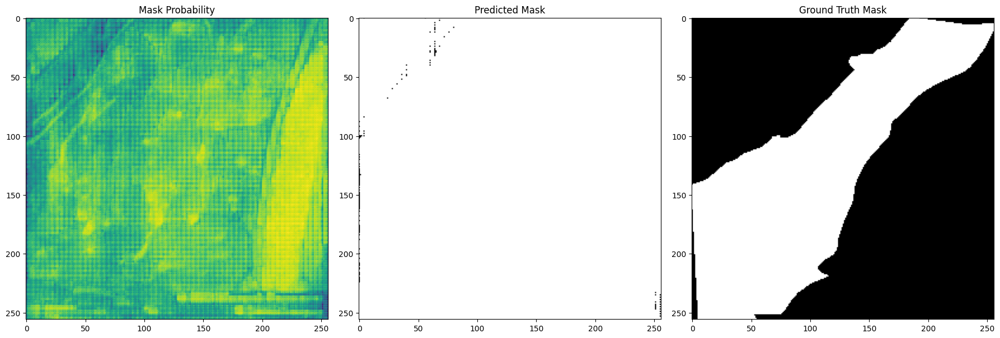

Accuracy for -104.884360899962_38.8362801837095.tif: 39.01%
response
 deployed_model_id: 8120933509125636096


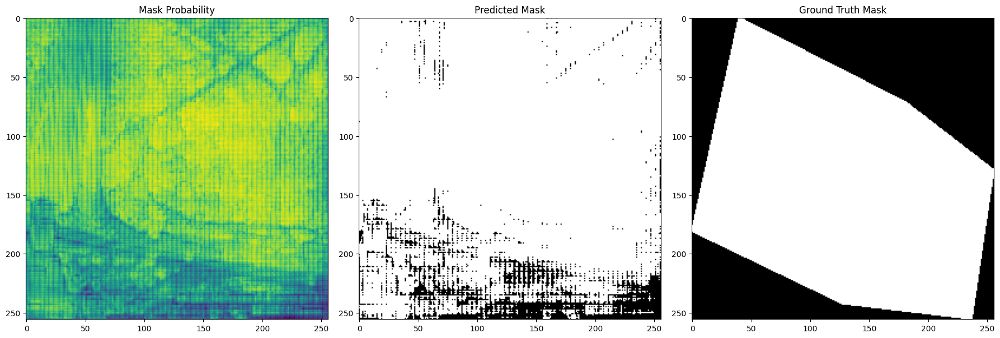

Accuracy for -109.715199293573_23.0498835300616.tif: 64.30%
response
 deployed_model_id: 8120933509125636096


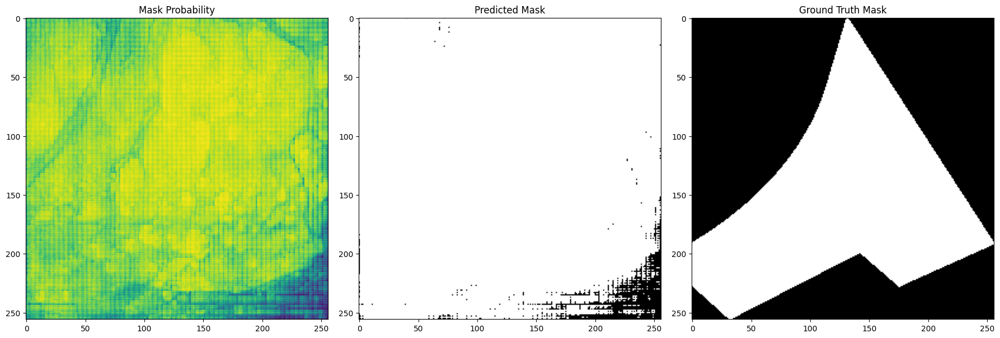

Accuracy for -116.194523099091_32.6164489258142.tif: 46.82%
response
 deployed_model_id: 8120933509125636096


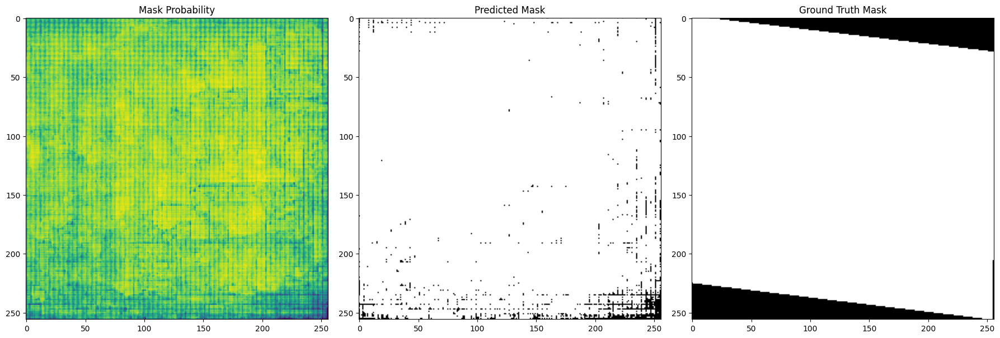

Accuracy for -116.293143634867_33.2481399813692.tif: 88.22%
response
 deployed_model_id: 8120933509125636096


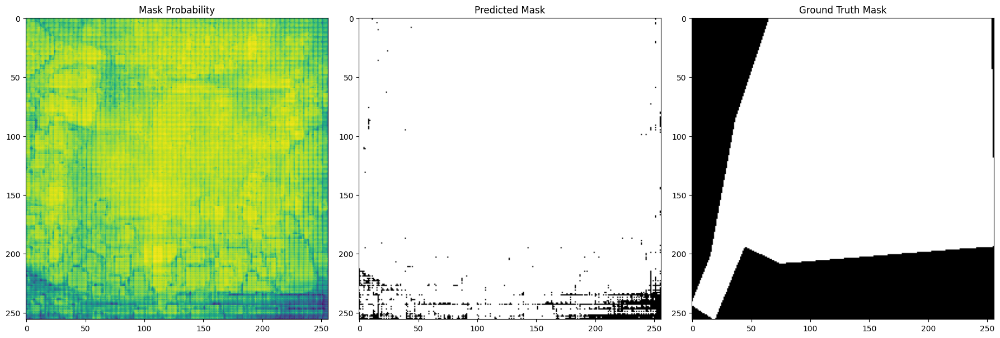

Accuracy for -116.516305538275_32.8281846236541.tif: 70.90%
response
 deployed_model_id: 8120933509125636096


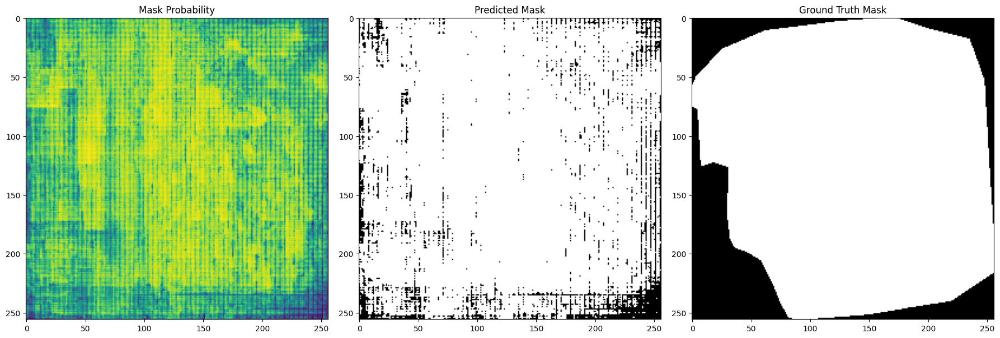

Accuracy for -116.660852163229_35.2653494841022.tif: 82.39%
response
 deployed_model_id: 8120933509125636096


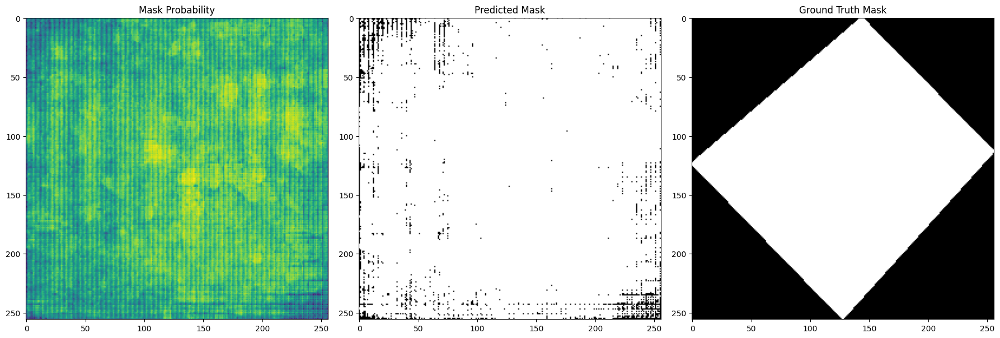

Accuracy for -116.717814224011_33.3353662608257.tif: 53.63%
response
 deployed_model_id: 8120933509125636096


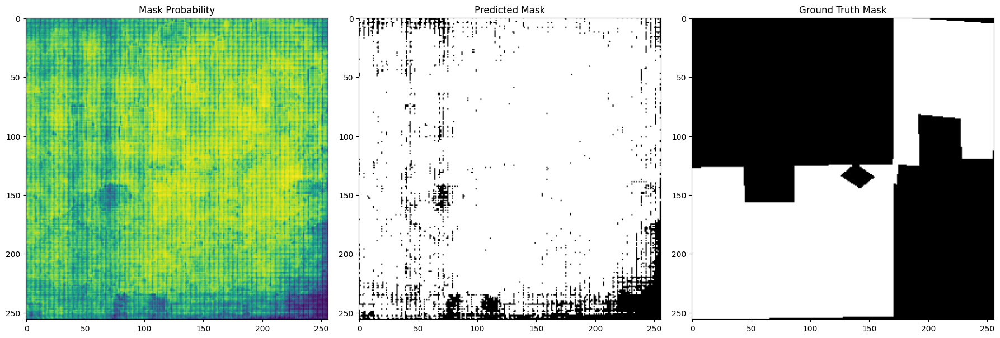

Accuracy for -116.738581806785_33.3492722668593.tif: 47.18%
Average Accuracy: 62.57%
Aggregated Confusion Matrix:
[[ 26646 231937]
 [ 13356 383421]]
Accuracy: 62.571%
Precision: 62.309%
Recall: 96.634%
F1 Score: 0.758


In [ ]:
if __name__ == "__main__":
    main()

In [ ]:
# results of test-100* (*MF should load this back into VertexAI for analysis, or use something like weights-and-biases to save history)

response
 deployed_model_id: 4225759636101267456


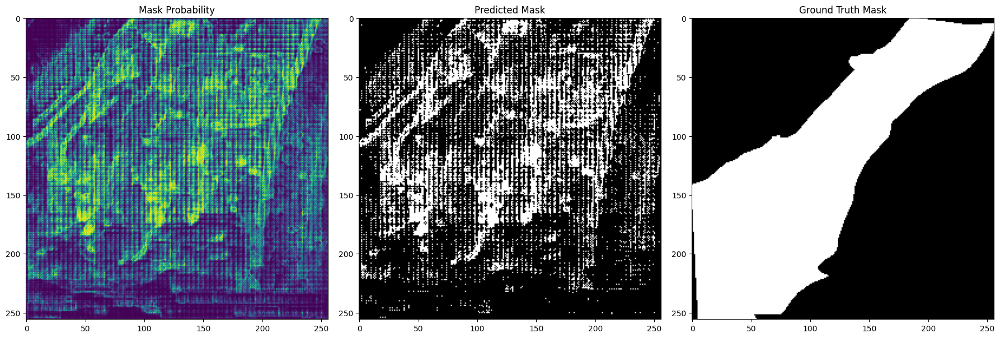

Accuracy for -104.884360899962_38.8362801837095.tif: 59.99%
response
 deployed_model_id: 4225759636101267456


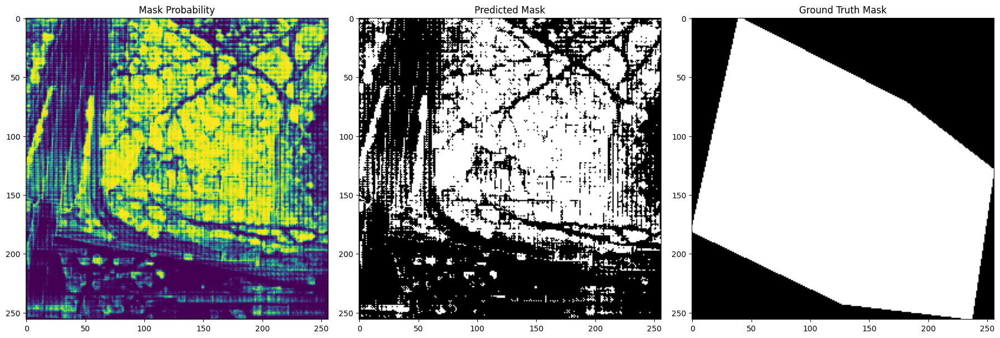

Accuracy for -109.715199293573_23.0498835300616.tif: 53.48%
response
 deployed_model_id: 4225759636101267456


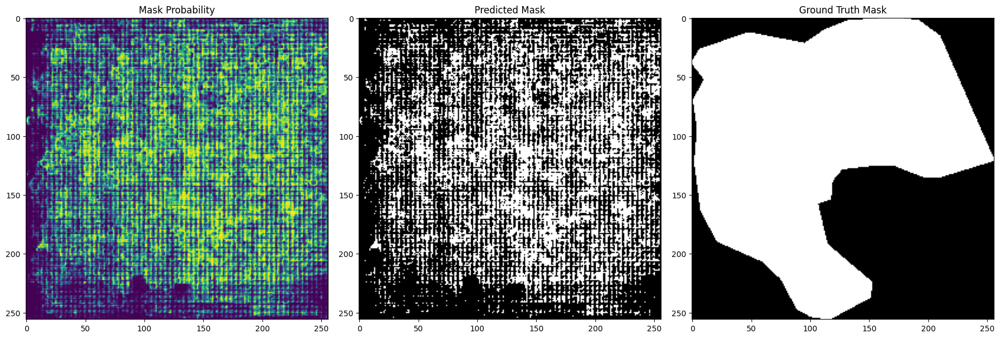

Accuracy for -2.04278822062114_36.8525241658598.tif: 52.18%
response
 deployed_model_id: 4225759636101267456


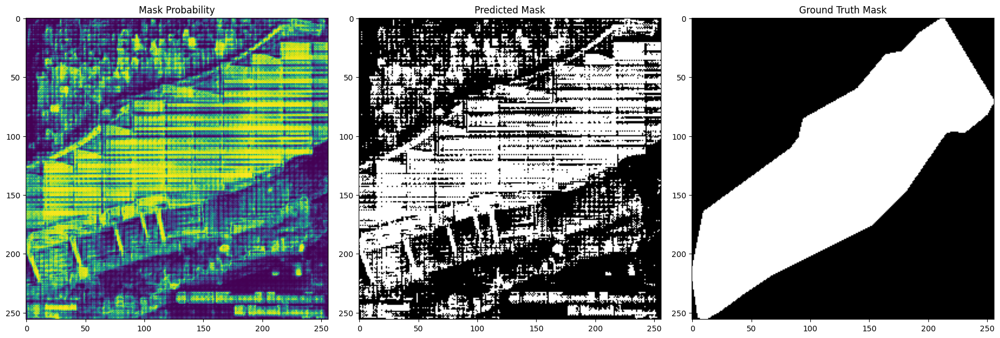

Accuracy for 11.0469246470669_47.4902018280142.tif: 66.97%
response
 deployed_model_id: 4225759636101267456


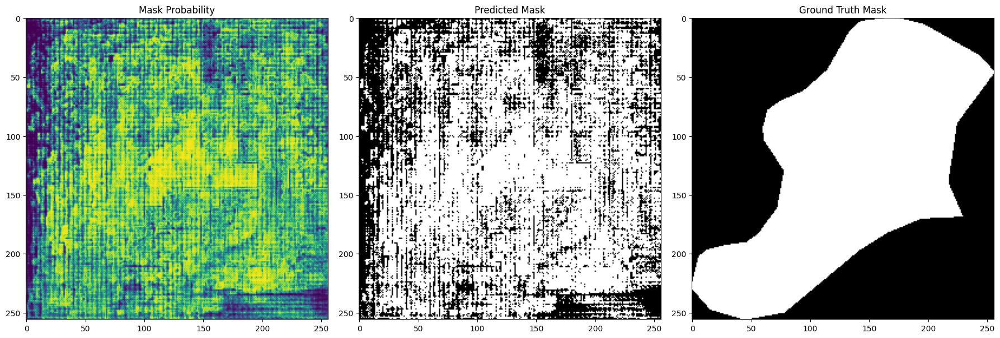

Accuracy for 13.3855899851572_54.104608228666.tif: 57.43%
response
 deployed_model_id: 4225759636101267456


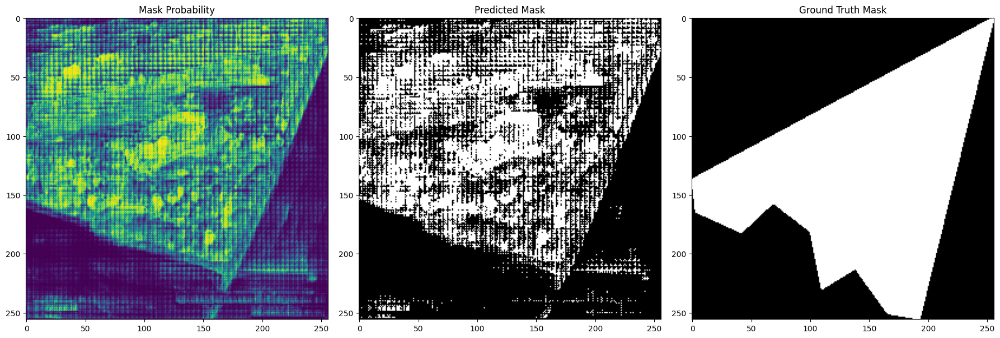

Accuracy for 16.5500687290936_47.7938419236521.tif: 60.01%
response
 deployed_model_id: 4225759636101267456


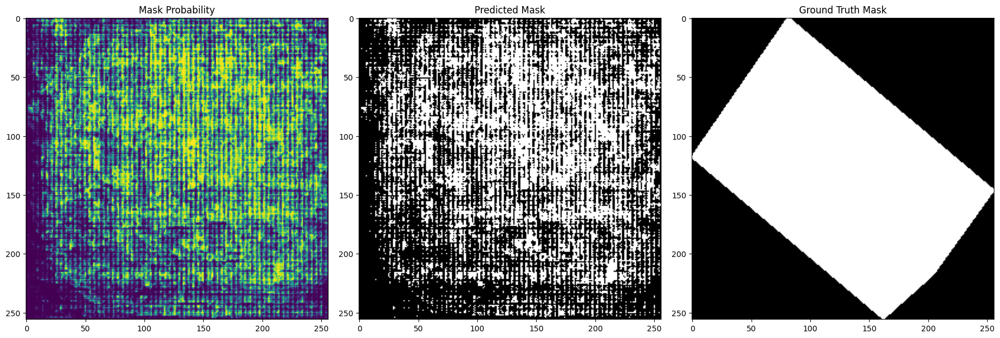

Accuracy for 37.6854069277347_55.6521245993058.tif: 59.64%
response
 deployed_model_id: 4225759636101267456


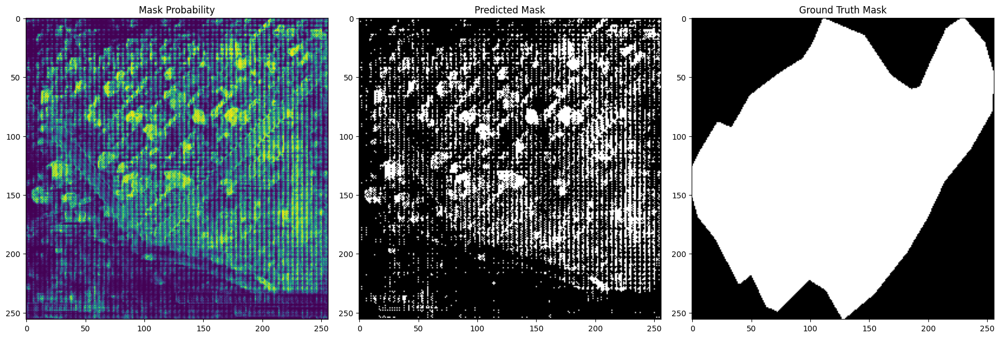

Accuracy for 9.48126992938993_50.3470104586191.tif: 47.90%
response
 deployed_model_id: 4225759636101267456


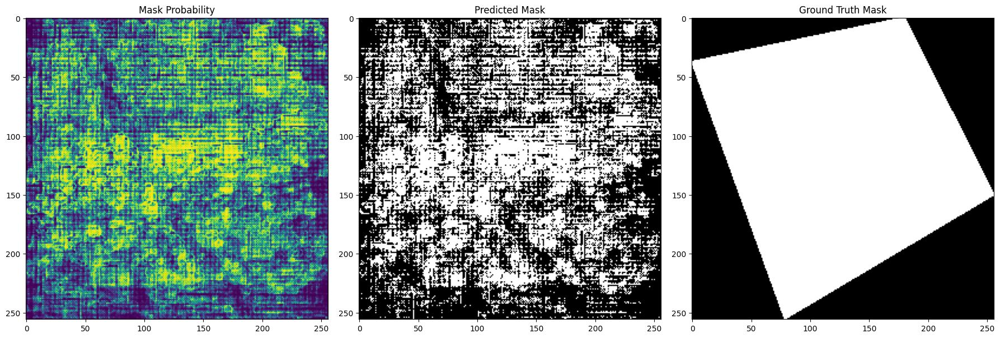

Accuracy for 9.50644349690266_52.1691159427922.tif: 59.40%
response
 deployed_model_id: 4225759636101267456


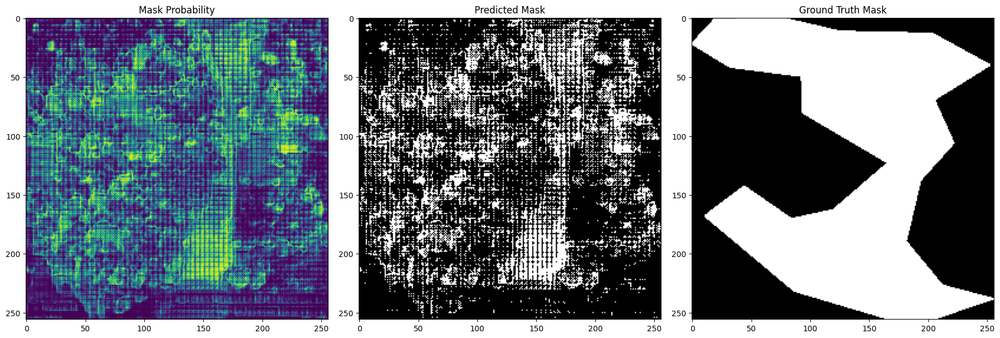

Accuracy for 9.54466505724293_48.7471655841542.tif: 53.70%
Average Accuracy: 114.14%
Aggregated Confusion Matrix:
[[432680 202012]
 [360660 315368]]
Accuracy: 57.072%
Precision: 60.955%
Recall: 46.650%
F1 Score: 0.529


In [28]:
def main():
    """Main function to process all files and print aggregated confusion matrix."""
    gcs_path = 'gs://meter-sam/test/'
    all_files = list_files_in_gcs_bucket(gcs_path+'image/')
    tif_files = [os.path.basename(f) for f in all_files if f.endswith('.tif')]
    # print(tif_files)
    
    for file_name in tif_files:
        process_file(file_name, gcs_path)
    
    # Calculate and print average accuracy
    num_images = len(tif_files)
    average_accuracy = sum_of_accuracies / num_images if num_images else 0
    print(f"Average Accuracy: {average_accuracy * 100:.2f}%")    
    
    # Print the aggregated confusion matrix
    print("Aggregated Confusion Matrix:")
    print(aggregate_confusion)
    
    # Compute metrics
    matric_accuracy, precision, recall, f1 = compute_metrics(aggregate_confusion)
    print(f"Accuracy: {matric_accuracy * 100:.3f}%")
    print(f"Precision: {precision * 100:.3f}%")
    print(f"Recall: {recall * 100:.3f}%")
    print(f"F1 Score: {f1:.3f}")

if __name__ == "__main__":
    main()

In [17]:
# Results for test-1000 validated with 100 records

In [18]:
# Results for test-5000 validated with 100 records

In [21]:
# Results for test-5000-large validated with 100 records